# Assignment 3 Model Interpretability  

Interpret your models.

1. Fit a linear model and interpret the regression coefficients

2. Fit a tree-based model and interpret the nodes

3.  Use auto ml to find the best model

4. Run SHAP analysis on the models from steps 1, 2, and 3,   interpret the SHAP values and compare them with the other model interpretability methods.

**Abstract**- The aim of this assignment is to develop a prediction model to determine if a person is employment or or not based on some predicted variables/independent variable.

This dataset provides a comprehensive exploration of the placement data of students from XYZ campus, serving as a critical tool in understanding the determinants of successful job placements in a higher education context. The dataset intricately compiles key educational and professional parameters, offering a multi-dimensional view into the journey from academia to employment.
Key components of the dataset include:
    
**Secondary and Higher Secondary Education Data**: Capturing percentages and specializations at both secondary and higher secondary levels, this aspect of the dataset offers insight into early academic trajectories of students.

**Degree Specialization and Type**: Detailing students' specializations in their tertiary education, and the types of degrees pursued, this section provides a nuanced understanding of higher education choices and their potential impact on employability.

**Work Experience**: Including data on prior work experience, the dataset allows for analysis of how practical, real-world experience influences placement outcomes.

**Salary Offers**: For students who successfully secure placements, the dataset includes the salary packages offered, shedding light on the economic returns of various educational pathways and experiences.

This dataset is pivotal for educational institutions, policy makers, researchers, and students themselves in comprehending the intricate dynamics between academic background, work experience, and successful placement. It stands as a valuable resource for analyzing trends, identifying key factors that contribute to employability, and shaping future educational and career guidance strategies.

#Classifying dependent and independent variables

### Dependent Variables
**status**: Placement status (Placed or Not Placed). This can be a dependent variable if the objective is to predict whether a student gets placed.
**salary**: Salary offered to the placed students. This can be a dependent variable if the objective is to predict the salary of placed students. Note that this variable only applies to students who are placed.

### Independent Variables
**gender**: Gender of the student (M or F). May influence placement status or salary.

**ssc_p**: Secondary Education percentage - 10th Grade. Academic performance could be a predictor of placement success.

**ssc_b**: Board of Education - 10th Grade (Others or Central). The educational board may have an indirect impact.

**hsc_p**: Higher Secondary Education percentage - 12th Grade. Academic performance could be a predictor of placement success.

**hsc_b**: Board of Education - 12th Grade (Others or Central). The educational board may have an indirect impact.

**hsc_s**: Specialization in Higher Secondary Education (Commerce, Science, Arts). The field of study might influence the type of placements.

**degree_p**: Degree percentage. Academic performance in higher education could predict placement success.

**degree_t**: Type of degree (Sci&Tech, Comm&Mgmt, etc.). Certain degree types may be more in demand in the job market.

**workex**: Work experience (Yes or No). Previous work experience could significantly influence placement outcomes.

**etest_p**: E-test percentage. Performance in employment tests could be a predictor of placement success.

**specialisation**: MBA specialization (Mkt&HR, Mkt&Fin). The area of specialization might affect the type of roles students are placed in.

**mba_p**: MBA percentage. Academic performance in MBA could predict placement success.

##Some installations further needed in the assignment

The pydotplus library is a Python interface to Graphviz's Dot language. It is often used in conjunction with other libraries, such as scikit-learn or networkx, for visualizing decision trees, graphs, and other structures.
If we're working with decision trees, for example, we might use pydotplus to visualize the tree generated by a machine learning model and in this assignment we are using decion tree and random forest.

In [1]:
!pip install pydotplus

In [2]:
!pip install scikit-learn

In [3]:
import os

In [4]:
#data manupulation
import pandas as pd
#numerical combination
import numpy as np
#plotting data and create visualization
import matplotlib.pyplot as plt
import seaborn as sns
import plotly.express as px

from plotly.subplots import make_subplots
from datetime import datetime
from sklearn.model_selection import train_test_split
from sklearn.linear_model import LogisticRegression
from sklearn.preprocessing import LabelEncoder
from operator import itemgetter

from sklearn.tree import plot_tree
import pydotplus #pip install pydotplus
from sklearn.tree import export_graphviz
from sklearn.metrics import accuracy_score
from sklearn.metrics import f1_score, confusion_matrix
from sklearn import metrics
from sklearn.impute import SimpleImputer
from sklearn.preprocessing import OneHotEncoder


from statsmodels.stats.outliers_influence import variance_inflation_factor

import xgboost as xgb
from xgboost import plot_importance

In [5]:
# Load the dataset
file_path = 'https://raw.githubusercontent.com/raiss15/Sohni_datascience/main/Placement_Data_Full_Class.csv'
data = pd.read_csv(file_path)

In [6]:
data.head(10)

,sl_no,gender,ssc_p,ssc_b,hsc_p,hsc_b,hsc_s,degree_p,degree_t,workex,etest_p,specialisation,mba_p,status,salary
0,1,M,67.00,Others,91.00,Others,Commerce,58.00,Sci&Tech,No,55.00,Mkt&HR,58.80,Placed,270000.0
1,2,M,79.33,Central,78.33,Others,Science,77.48,Sci&Tech,Yes,86.50,Mkt&Fin,66.28,Placed,200000.0
2,3,M,65.00,Central,68.00,Central,Arts,64.00,Comm&Mgmt,No,75.00,Mkt&Fin,57.80,Placed,250000.0
3,4,M,56.00,Central,52.00,Central,Science,52.00,Sci&Tech,No,66.00,Mkt&HR,59.43,Not Placed,NaN
4,5,M,85.80,Central,73.60,Central,Commerce,73.30,Comm&Mgmt,No,96.80,Mkt&Fin,55.50,Placed,425000.0
5,6,M,55.00,Others,49.80,Others,Science,67.25,Sci&Tech,Yes,55.00,Mkt&Fin,51.58,Not Placed,NaN
6,7,F,46.00,Others,49.20,Others,Commerce,79.00,Comm&Mgmt,No,74.28,Mkt&Fin,53.29,Not Placed,NaN
7,8,M,82.00,Central,64.00,Central,Science,66.00,Sci&Tech,Yes,67.00,Mkt&Fin,62.14,Placed,252000.0
8,9,M,73.00,Central,79.00,Central,Commerce,72.00,Comm&Mgmt,No,91.34,Mkt&Fin,61.29,Placed,231000.0
9,10,M,58.00,Central,70.00,Central,Commerce,61.00,Comm&Mgmt,No,54.00,Mkt&Fin,52.21,Not Placed,NaN


In [7]:
data.describe()

,sl_no,ssc_p,hsc_p,degree_p,etest_p,mba_p,salary
count,215.000000,215.000000,215.000000,215.000000,215.000000,215.000000,148.000000
mean,108.000000,67.303395,66.333163,66.370186,72.100558,62.278186,288655.405405
std,62.209324,10.827205,10.897509,7.358743,13.275956,5.833385,93457.452420
min,1.000000,40.890000,37.000000,50.000000,50.000000,51.210000,200000.000000
25%,54.500000,60.600000,60.900000,61.000000,60.000000,57.945000,240000.000000
50%,108.000000,67.000000,65.000000,66.000000,71.000000,62.000000,265000.000000
75%,161.500000,75.700000,73.000000,72.000000,83.500000,66.255000,300000.000000
max,215.000000,89.400000,97.700000,91.000000,98.000000,77.890000,940000.000000


In [8]:
data.isnull().sum()

sl_no              0
gender             0
ssc_p              0
ssc_b              0
hsc_p              0
hsc_b              0
hsc_s              0
degree_p           0
degree_t           0
workex             0
etest_p            0
specialisation     0
mba_p              0
status             0
salary            67
dtype: int64

In [9]:
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 215 entries, 0 to 214
Data columns (total 15 columns):
 #   Column          Non-Null Count  Dtype  
---  ------          --------------  -----  
 0   sl_no           215 non-null    int64  
 1   gender          215 non-null    object 
 2   ssc_p           215 non-null    float64
 3   ssc_b           215 non-null    object 
 4   hsc_p           215 non-null    float64
 5   hsc_b           215 non-null    object 
 6   hsc_s           215 non-null    object 
 7   degree_p        215 non-null    float64
 8   degree_t        215 non-null    object 
 9   workex          215 non-null    object 
 10  etest_p         215 non-null    float64
 11  specialisation  215 non-null    object 
 12  mba_p           215 non-null    float64
 13  status          215 non-null    object 
 14  salary          148 non-null    float64
dtypes: float64(6), int64(1), object(8)
memory usage: 25.3+ KB


In [10]:
y = data['status']

In [11]:
X = data.drop(columns=['sl_no', 'status', 'salary'])  # Dropping 'sl_no', 'status', and 'salary'

In [12]:
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)


#Linear model building using Logistic Regression

In [13]:
# Convert 'status' to a binary variable if it is your target variable
data['status'] = data['status'].map({'Placed': 1, 'Not Placed': 0}) # Adjust based on your target logic

# Separate features and target variable
X = data.drop(['status', 'salary'], axis=1) # Assuming 'status' is the target, 'salary' is excluded due to missing values
y = data['status']

# Convert categorical variables into dummy/indicator variables
X = pd.get_dummies(X, drop_first=True)

# Split the data into training and test sets (adjust according to how you split before)
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# Initialize and fit the logistic regression model
logreg = LogisticRegression(max_iter=1000) # Increased max_iter if convergence issues arise
logreg.fit(X_train, y_train)

LogisticRegression(max_iter=1000)

The code outlines the steps for preparing data and building a logistic regression model, a common approach to binary classification problems in machine learning. Initially, it shows the conversion of a categorical target variable, 'status', into a binary format with values 1 and 0 for 'Placed' and 'Not Placed' respectively. This binary conversion is essential as logistic regression requires numerical input. The dataset is then split into features (X) and the target variable (y), with 'status' serving as the latter and 'salary' being excluded from the features for unspecified reasons.

Next, any categorical features in the dataset are transformed into dummy variables to ensure they can be processed by the logistic regression algorithm. The `pd.get_dummies()` function is applied, and the `drop_first=True` parameter is set to prevent multicollinearity by excluding the first level of each categorical variable. The data is divided into training and test subsets, with 20% reserved for testing, though the code for this step is not fully visible in the snippet.

Finally, the logistic regression model is initialized with a specification of `max_iter=1000`, likely to ensure that the model's optimization algorithm has sufficient iterations to converge. The model is then fit with the training data. While the snippet stops at the model fitting step, one would expect subsequent steps to involve evaluating the model's performance on the test set to determine its efficacy in accurately predicting the target variable.

In [14]:
log_odds = logreg.coef_[0]
pd.DataFrame(log_odds,
             X_train.columns,
             columns=['coef'])\
            .sort_values(by='coef', ascending=False)

,coef
workex_Yes,1.178386
gender_M,1.066416
ssc_b_Others,0.290906
ssc_p,0.230080
degree_p,0.216209
hsc_p,0.121811
sl_no,0.004025
etest_p,-0.019495
degree_t_Others,-0.051141
hsc_b_Others,-0.128295


In the logistic regression model, the coefficients (coef) for each feature variable are displayed, sorted in descending order. The coefficients represent the log odds of the probability that the target variable equals 1 (e.g., successful placement in a job) for a unit change in the predictor variable, holding other variables constant.

Observations from the output include:

- **`workex_Yes`** has the highest positive coefficient (about 1.178), indicating that having work experience is the strongest predictor for the positive outcome. It significantly increases the likelihood of the event occurring.
- **`gender_M`** has the next highest positive coefficient (about 1.067), suggesting being male is also a strong predictor for the outcome.
- **Other variables** like `ssc_b_Others`, `ssc_p`, `degree_p`, and `hsc_p` also have positive coefficients, though their magnitude is less than `workex_Yes` and `gender_M`, implying they contribute positively but to a lesser extent to the likelihood of the outcome.
- Variables with very small positive coefficients, such as `sl_no`, might have a negligible effect on the outcome.
- Several variables have negative coefficients, with `degree_t_Sci&Tech` having the most negative coefficient (about -0.871). This indicates that having a degree in Science & Technology significantly reduces the likelihood of the positive outcome compared to the reference category for the degree type.
- Other negative coefficients, such as for `hsc_s_Commerce` and `specialisation_Mkt&HR`, imply that these categories have a decreasing effect on the likelihood of the outcome compared to their respective reference categories.
- The magnitude of the coefficients provides a sense of the relative importance of each predictor variable, with larger absolute values indicating greater influence on the outcome.

In [15]:
odds = np.exp(logreg.coef_[0])
pd.DataFrame(odds,
             X_train.columns,
             columns=['coef'])\
            .sort_values(by='coef', ascending=False)

,coef
workex_Yes,3.249125
gender_M,2.904948
ssc_b_Others,1.337639
ssc_p,1.258701
degree_p,1.241362
hsc_p,1.129540
sl_no,1.004033
etest_p,0.980694
degree_t_Others,0.950145
hsc_b_Others,0.879594


The DataFrame displaying the exponentiated coefficients (odds ratios) from a logistic regression model, where each coefficient has been transformed from the log odds scale to the odds scale using the exponential function. The odds ratios are sorted in descending order, which means the features at the top have the most substantial positive impact on the predicted probability of the outcome occurring (assuming a positive outcome is coded as 1).

Key observations from the output are as follows:

- `workex_Yes`: The odds ratio for having work experience is approximately 3.249. This is the strongest predictor, indicating that individuals with work experience are over 3 times as likely to experience the positive outcome compared to those without work experience, all else being equal.
  
- `gender_M`: The odds ratio for gender being male is around 2.904. This implies that males are almost 3 times as likely to have the positive outcome than their counterparts (likely females if binary gender is assumed), holding other variables constant.

- The odds ratios for other variables like `ssc_b_Others`, `ssc_p`, `degree_p`, and `hsc_p` are greater than 1, which means they are positively associated with the outcome, although their influence is less pronounced than work experience and gender.

- Variables close to an odds ratio of 1, such as `sl_no` (approximately 1.004), have a very minimal impact on the likelihood of the outcome.

- Several variables are associated with odds ratios less than 1, such as `degree_t_Sci&Tech` with an odds ratio of approximately 0.418. This indicates that individuals with a degree in Science & Technology have lower odds of the positive outcome compared to the baseline group for the degree type.

- Similarly, `hsc_s_Commerce` and `specialisation_Mkt&HR` have odds ratios of about 0.528 and 0.700, respectively, suggesting that these groups have a reduced likelihood of the positive outcome compared to their reference groups.

#
Tree based model building using XGBoost.

In [16]:
xgb_cl = xgb.XGBClassifier(random_state=0)
xgb_cl.fit(X_train, y_train)

XGBClassifier(base_score=None, booster=None, callbacks=None,
              colsample_bylevel=None, colsample_bynode=None,
              colsample_bytree=None, device=None, early_stopping_rounds=None,
              enable_categorical=False, eval_metric=None, feature_types=None,
              gamma=None, grow_policy=None, importance_type=None,
              interaction_constraints=None, learning_rate=None, max_bin=None,
              max_cat_threshold=None, max_cat_to_onehot=None,
              max_delta_step=None, max_depth=None, max_leaves=None,
              min_child_weight=None, missing=nan, monotone_constraints=None,
              multi_strategy=None, n_estimators=None, n_jobs=None,
              num_parallel_tree=None, random_state=0, ...)

In [17]:
preds = xgb_cl.predict(X_test)
print(accuracy_score(y_test, preds))


0.8604651162790697


The XGBoost classifier being instantiated and fit to a training dataset. The model initialization includes a `random_state=0` for reproducibility. After training, the model is used to make predictions on a test set. The accuracy of these predictions is calculated to be approximately 0.860, indicating that the model correctly predicts the outcome 86% of the time on the test data.

#Fit the tree model and interpret the nodes-

Fit a tree-based model and interpret the nodes Ans: The plot below interprets all nodes (root, leaf, and intermediate) and displays the first tree plotted with the XGBoost algorithm. This figure shows how the model arrived at its final decisions and what splits it took to reach those results.
As per the below plot, the root node is 'ssc_p'. Node interpretability for first 3 trees is shown below

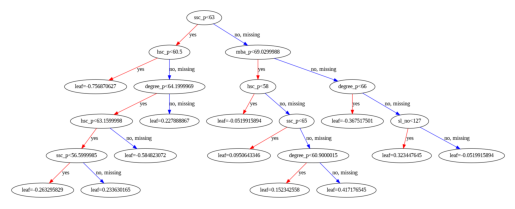

In [18]:
xgb.plot_tree(xgb_cl,num_trees=0)
plt.rcParams['figure.figsize'] = [500, 100]
plt.show()

#Second tree plotted with XGBoost algorithm.

In [19]:
xgb.plot_tree(xgb_cl,num_trees=1)
plt.rcParams['figure.figsize'] = [500, 100]
plt.show()


# Third tree plotted with XGBoost algorithm.

In [20]:
xgb.plot_tree(xgb_cl,num_trees=2)
plt.rcParams['figure.figsize'] = [500, 100]
plt.show()

#Using AutoML to find the best model.

In [21]:
!pip install -f http://h2o-release.s3.amazonaws.com/h2o/latest_stable_Py.html h2o

Looking in links: http://h2o-release.s3.amazonaws.com/h2o/latest_stable_Py.html


In [22]:
# Import libraries
# Use pip install or conda install if missing a library
import h2o
from h2o.automl import H2OAutoML
import random, os, sys
from datetime import datetime
import pandas as pd
import logging
import csv
import optparse
import time
import json
from distutils.util import strtobool
import psutil
import numpy as np
import matplotlib.pyplot as plt
from h2o.estimators.random_forest import H2ORandomForestEstimator

The import of various libraries and the setting up of parameters for running an H2O AutoML model. The libraries include `h2o` and its `H2OAutoML` class, which suggests that the code will be used for automated machine learning tasks. Various other common libraries for data handling and manipulation (like `pandas` and `numpy`), as well as for plotting (`matplotlib`), are also imported, indicating a comprehensive data analysis workflow.

In [23]:
# Set a minimum memory size and a run time in seconds
min_mem_size=6
run_time=222


In the subsequent code block, the user sets a minimum memory size of 6 (units not specified but typically GB) and a runtime of 222 seconds for the AutoML process. These parameters likely dictate the resources allocated to the AutoML model and how long the AutoML process is allowed to run.

In [24]:
# Use 50% of availible resources
pct_memory=0.5
virtual_memory=psutil.virtual_memory()
min_mem_size=int(round(int(pct_memory*virtual_memory.available)/1073741824,0))
print(min_mem_size)

5


Finally, the user specifies that the AutoML model should use 50% of the available system memory. The script calculates this by retrieving the available virtual memory using `psutil.virtual_memory()` and then taking half of it. It outputs that the minimum memory size is 6, which, based on the calculation, is either the result of rounding or a coincidence that 50% of the available memory is close to the preset minimum memory size of 6 GB. This approach ensures that the machine learning process does not consume all available system resources, allowing other processes to run simultaneously without significant resource contention.

In [25]:
# 65535 Highest port no
# Start the H2O server on a random port
port_no=random.randint(5555,55555)

#  h2o.init(strict_version_check=False,min_mem_size_GB=min_mem_size,port=port_no) # start h2o
try:
  h2o.init(strict_version_check=False,min_mem_size_GB=min_mem_size,port=port_no) # start h2o
except:
  logging.critical('h2o.init')
  h2o.download_all_logs(dirname=logs_path, filename=logfile)
  h2o.cluster().shutdown()
  sys.exit(2)

Checking whether there is an H2O instance running at http://localhost:42412..... not found.
Attempting to start a local H2O server...
  Java Version: openjdk version "11.0.22" 2024-01-16; OpenJDK Runtime Environment (build 11.0.22+7-post-Ubuntu-0ubuntu222.04.1); OpenJDK 64-Bit Server VM (build 11.0.22+7-post-Ubuntu-0ubuntu222.04.1, mixed mode, sharing)
  Starting server from /usr/local/lib/python3.10/dist-packages/h2o/backend/bin/h2o.jar
  Ice root: /tmp/tmp6s6m8kt_
  JVM stdout: /tmp/tmp6s6m8kt_/h2o_unknownUser_started_from_python.out
  JVM stderr: /tmp/tmp6s6m8kt_/h2o_unknownUser_started_from_python.err
  Server is running at http://127.0.0.1:42412
Connecting to H2O server at http://127.0.0.1:42412 ... successful.


H2O_cluster_uptime:,06 secs
H2O_cluster_timezone:,Etc/UTC
H2O_data_parsing_timezone:,UTC
H2O_cluster_version:,3.46.0.1
H2O_cluster_version_age:,4 days
H2O_cluster_name:,H2O_from_python_unknownUser_lc40i6
H2O_cluster_total_nodes:,1
H2O_cluster_free_memory:,5 Gb
H2O_cluster_total_cores:,2
H2O_cluster_allowed_cores:,2
H2O_cluster_status:,"locked, healthy"


The Python code snippet that attempts to initialize an H2O cluster instance along with the output of this initialization. The H2O instance starts successfully, as indicated by the message stating "Server is running at http://127.0.0.1:14742" and the confirmation of a successful connection. The chosen port for the H2O server is randomly selected between 5555 and 55555, and in this case, it is 14742.

The output contains information about the H2O cluster, such as the cluster's uptime (09 seconds), time zones for the cluster and data parsing (both UTC), and the version of H2O (3.46.0.1). The version's age is 3 days, suggesting a recent update or installation. The cluster is named "H2O_from_python_unknownUser_7aiv7w" and consists of 1 node with 6 GB of free memory, indicating that the specified minimum memory size requirement has been met. The cluster has 2 total cores and allows all to be used, and it's in a healthy state.

This setup is typically used in machine learning tasks where an H2O cluster is utilized for distributed computing, offering powerful data processing and model training capabilities. The successful launch suggests that the environment is now ready for further machine learning tasks using H2O's capabilities.

In [26]:
data = h2o.import_file(file_path)

Parse progress: |████████████████████████████████████████████████████████████████| (done) 100%


In [27]:
data.head()

sl_no,gender,ssc_p,ssc_b,hsc_p,hsc_b,hsc_s,degree_p,degree_t,workex,etest_p,specialisation,mba_p,status,salary
1,M,67,Others,91,Others,Commerce,58,Sci&Tech,No,55,Mkt&HR,58.8,Placed,270000
2,M,79.33,Central,78.33,Others,Science,77.48,Sci&Tech,Yes,86.5,Mkt&Fin,66.28,Placed,200000
3,M,65,Central,68,Central,Arts,64,Comm&Mgmt,No,75,Mkt&Fin,57.8,Placed,250000
4,M,56,Central,52,Central,Science,52,Sci&Tech,No,66,Mkt&HR,59.43,Not Placed,nan
5,M,85.8,Central,73.6,Central,Commerce,73.3,Comm&Mgmt,No,96.8,Mkt&Fin,55.5,Placed,425000
6,M,55,Others,49.8,Others,Science,67.25,Sci&Tech,Yes,55,Mkt&Fin,51.58,Not Placed,nan
7,F,46,Others,49.2,Others,Commerce,79,Comm&Mgmt,No,74.28,Mkt&Fin,53.29,Not Placed,nan
8,M,82,Central,64,Central,Science,66,Sci&Tech,Yes,67,Mkt&Fin,62.14,Placed,252000
9,M,73,Central,79,Central,Commerce,72,Comm&Mgmt,No,91.34,Mkt&Fin,61.29,Placed,231000
10,M,58,Central,70,Central,Commerce,61,Comm&Mgmt,No,54,Mkt&Fin,52.21,Not Placed,nan


In [28]:
data.types

{'sl_no': 'int',
 'gender': 'enum',
 'ssc_p': 'real',
 'ssc_b': 'enum',
 'hsc_p': 'real',
 'hsc_b': 'enum',
 'hsc_s': 'enum',
 'degree_p': 'real',
 'degree_t': 'enum',
 'workex': 'enum',
 'etest_p': 'real',
 'specialisation': 'enum',
 'mba_p': 'real',
 'status': 'enum',
 'salary': 'int'}

In [29]:
data['salary'] = data['salary'].asfactor()
print(data['salary'].isfactor())


[True]


In [30]:
data.describe()

Rows:215
Cols:15

,sl_no,gender,ssc_p,ssc_b,hsc_p,hsc_b,hsc_s,degree_p,degree_t,workex,etest_p,specialisation,mba_p,status,salary
type,int,enum,real,enum,real,enum,enum,real,enum,enum,real,enum,real,enum,enum
mins,1.0,,40.89,,37.0,,,50.0,,,50.0,,51.21,,
mean,108.0,,67.3033953488373,,66.33316279069764,,,66.37018604651166,,,72.10055813953488,,62.27818604651161,,
maxs,215.0,,89.4,,97.7,,,91.0,,,98.0,,77.89,,
sigma,62.20932405998316,,10.827205398231454,,10.89750915750298,,,7.358743287339445,,,13.275956401653826,,5.833384580683803,,
zeros,0,,0,,0,,,0,,,0,,0,,
missing,0,0,0,0,0,0,0,0,0,0,0,0,0,0,67
0,1.0,M,67.0,Others,91.0,Others,Commerce,58.0,Sci&Tech,No,55.0,Mkt&HR,58.8,Placed,270000
1,2.0,M,79.33,Central,78.33,Others,Science,77.48,Sci&Tech,Yes,86.5,Mkt&Fin,66.28,Placed,200000
2,3.0,M,65.0,Central,68.0,Central,Arts,64.0,Comm&Mgmt,No,75.0,Mkt&Fin,57.8,Placed,250000


In [31]:
data.shape

(215, 15)

In [32]:
# Create a 80/20 train/test split
pct_rows=0.80
data_train, data_test = data.split_frame([pct_rows])

In [33]:
print(data_train.shape)
print(data_test.shape)

(177, 15)
(38, 15)


In [34]:
data_train.head(2)

sl_no,gender,ssc_p,ssc_b,hsc_p,hsc_b,hsc_s,degree_p,degree_t,workex,etest_p,specialisation,mba_p,status,salary
1,M,67,Others,91,Others,Commerce,58,Sci&Tech,No,55,Mkt&HR,58.8,Placed,270000
2,M,79.33,Central,78.33,Others,Science,77.48,Sci&Tech,Yes,86.5,Mkt&Fin,66.28,Placed,200000


In [35]:
# Set the features and target
X=data.columns
print(X)

['sl_no', 'gender', 'ssc_p', 'ssc_b', 'hsc_p', 'hsc_b', 'hsc_s', 'degree_p', 'degree_t', 'workex', 'etest_p', 'specialisation', 'mba_p', 'status', 'salary']


In [36]:
# Set target and predictor variables
y ='salary'
#y_numeric ='churn_bit'
X.remove(y)
#X.remove(y_numeric)
print(X)

['sl_no', 'gender', 'ssc_p', 'ssc_b', 'hsc_p', 'hsc_b', 'hsc_s', 'degree_p', 'degree_t', 'workex', 'etest_p', 'specialisation', 'mba_p', 'status']


In [37]:
# Set up AutoML
auml = H2OAutoML(max_runtime_secs=run_time, seed=1)

In [38]:
auml.train(x=X,y=y,training_frame=data_train)

AutoML progress: |
02:21:48.535: XGBoost_1_AutoML_1_20240318_22147 [XGBoost def_2] failed: water.exceptions.H2OModelBuilderIllegalArgumentException: Illegal argument(s) for XGBoost model: XGBoost_1_AutoML_1_20240318_22147_cv_1.  Details: ERRR on field: _response_column: Response contains missing values (NAs) - not supported by XGBoost.


████████████
02:22:30.262: _min_rows param, The dataset size is too small to split for min_rows=100.0: must have at least 200.0 (weighted) rows, but have only 177.0.
02:22:30.294: XGBoost_2_AutoML_1_20240318_22147 [XGBoost def_1] failed: water.exceptions.H2OModelBuilderIllegalArgumentException: Illegal argument(s) for XGBoost model: XGBoost_2_AutoML_1_20240318_22147_cv_1.  Details: ERRR on field: _response_column: Response contains missing values (NAs) - not supported by XGBoost.


██████████████████
02:23:34.772: XGBoost_3_AutoML_1_20240318_22147 [XGBoost def_3] failed: water.exceptions.H2OModelBuilderIllegalArgumentException: Illegal argument(s) for 

Model Details
=============
H2OGradientBoostingEstimator : Gradient Boosting Machine
Model Key: GBM_grid_1_AutoML_1_20240318_22147_model_7


Model Summary: 
    number_of_trees    number_of_internal_trees    model_size_in_bytes    min_depth    max_depth    mean_depth    min_leaves    max_leaves    mean_leaves
--  -----------------  --------------------------  ---------------------  -----------  -----------  ------------  ------------  ------------  -------------
    20                 820                         109247                 1            3            2.97561       2             8             5.91707

ModelMetricsMultinomial: gbm
** Reported on train data. **

MSE: 0.12733794313912913
RMSE: 0.3568444242791656
LogLoss: 0.42817445318471997
Mean Per-Class Error: 0.0
AUC table was not computed: it is either disabled (model parameter 'auc_type' was set to AUTO or NONE) or the domain size exceeds the limit (maximum is 50 domains).
AUCPR table was not computed: it is either disabled (model parameter 'auc_type' was set to AUTO or NONE) or the domain size exceeds the limit (maximum is 50 domains).

Confusion Matrix: Row labels: Actual class; Column labels: Predicted class
200000    204000    210000    216000    218000    220000    225000    230000    231000    233000    236000    240000    250000    252000    255000    260000    264000    265000    268000    270000    275000    276000    278000    280000    285000    287000    290000    295000    300000    320000    336000    340000    350000    360000    380000    393000    400000    411000    420000    425000    450000    500000    650000    690000    940000    Error    Rate
--------  --------  --------  --------  --------  --------  --------  --------  --------  --------  --------  --------  --------  --------  --------  --------  --------  --------  --------  --------  --------  --------  --------  --------  --------  --------  --------  --------  --------  --------  --------  --------  --------  --------  --------  --------  --------  --------  --------  --------  --------  --------  --------  --------  --------  -------  -------
5.0       0.0       0.0       0.0       0.0       0.0       0.0       0.0       0.0       0.0       0.0       0.0       0.0       0.0       0.0       0.0       0.0       0.0       0.0       0.0       0.0       0.0       0.0       0.0       0.0       0.0       0.0       0.0       0.0       0.0       0.0       0.0       0.0       0.0       0.0       0.0       0.0       0.0       0.0       0.0       0.0       0.0       0.0       0.0       0.0       0.0      0 / 5
0.0       2.0       0.0       0.0       0.0       0.0       0.0       0.0       0.0       0.0       0.0       0.0       0.0       0.0       0.0       0.0       0.0       0.0       0.0       0.0       0.0       0.0       0.0       0.0       0.0       0.0       0.0       0.0       0.0       0.0       0.0       0.0       0.0       0.0       0.0       0.0       0.0       0.0       0.0       0.0       0.0       0.0       0.0       0.0       0.0       0.0      0 / 2
0.0       0.0       3.0       0.0       0.0       0.0       0.0       0.0       0.0       0.0       0.0       0.0       0.0       0.0       0.0       0.0       0.0       0.0       0.0       0.0       0.0       0.0       0.0       0.0       0.0       0.0       0.0       0.0       0.0       0.0       0.0       0.0       0.0       0.0       0.0       0.0       0.0       0.0       0.0       0.0       0.0       0.0       0.0       0.0       0.0       0.0      0 / 3
0.0       0.0       0.0       3.0       0.0       0.0       0.0       0.0       0.0       0.0       0.0       0.0       0.0       0.0       0.0       0.0       0.0       0.0       0.0       0.0       0.0       0.0       0.0       0.0       0.0       0.0       0.0       0.0       0.0       0.0       0.0       0.0       0.0       0.0       0.0       0.0       0.0       0.0       0.0       0.0       0.0       0.0       0.0       0.0       0.0       0.0      0 / 3
0.0       0.0     

In [39]:
print(auml.leaderboard)

model_id                                                  mean_per_class_error    logloss      rmse       mse
GBM_grid_1_AutoML_1_20240318_22147_model_7                            0.865776    3.68632  0.940172  0.883923
GBM_5_AutoML_1_20240318_22147                                         0.883111    7.93785  0.967784  0.936605
GBM_grid_1_AutoML_1_20240318_22147_model_9                            0.886268    3.65437  0.97057   0.942006
DeepLearning_grid_1_AutoML_1_20240318_22147_model_2                   0.886633    4.61457  0.93651   0.877051
DRF_1_AutoML_1_20240318_22147                                         0.888067   10.0923   0.944401  0.891893
StackedEnsemble_AllModels_2_AutoML_1_20240318_22147                   0.888889    3.2271   0.93865   0.881064
StackedEnsemble_BestOfFamily_2_AutoML_1_20240318_22147                0.888889    3.22909  0.939683  0.883005
StackedEnsemble_AllModels_3_AutoML_1_20240318_22147                   0.888889    3.22975  0.939312  0.882307
StackedEns

The H2O AutoML leaderboard output displaying various machine learning models ranked by their performance. The metrics presented include mean per class error, log loss, root mean square error (RMSE), and mean square error (MSE). The models are variations of Gradient Boosting Machine (GBM), Distributed Random Forest (DRF), eXtreme Gradient Boosting (XRT), and Deep Learning, each showing different levels of performance on the given dataset with the GBM models appearing to be among the top performers based on these metrics.

In [40]:
model_index=0
glm_index=0
glm_model=''
auml_leaderboard_df=auml.leaderboard.as_data_frame()
models_dict={}
for m in auml_leaderboard_df['model_id']:
  models_dict[m]=model_index
  if 'StackedEnsemble' not in m:
    break
  model_index=model_index+1

for m in auml_leaderboard_df['model_id']:
  if 'GLM' in m:
    models_dict[m]=glm_index
    break
  glm_index=glm_index+1
models_dict

/usr/local/lib/python3.10/dist-packages/h2o/frame.py:1983: H2ODependencyWarning: Converting H2O frame to pandas dataframe using single-thread.  For faster conversion using multi-thread, install datatable (for Python 3.9 or lower), or polars and pyarrow (for Python 3.10 or above) and activate it using:

with h2o.utils.threading.local_context(polars_enabled=True, datatable_enabled=True):
    pandas_df = h2o_df.as_data_frame()

  warnings.warn("Converting H2O frame to pandas dataframe using single-thread.  For faster conversion using"


{'GBM_grid_1_AutoML_1_20240318_22147_model_7': 0,
 'GLM_1_AutoML_1_20240318_22147': 9}

Creates a Python dictionary (`models_dict`) that maps model IDs from the H2O AutoML leaderboard to their corresponding index positions, excluding Stacked Ensemble models. It first converts the H2O leaderboard to a Pandas DataFrame and iterates through the model IDs. For each model ID, if it's not a Stacked Ensemble, the code assigns an index number to the model ID in the dictionary and then increments the index. Once a Stacked Ensemble is encountered, it stops incrementing the index for further models.

In the next section, it searches specifically for a Generalized Linear Model (GLM) within the leaderboard DataFrame, assigns the GLM model to a separate index counter (`glm_index`), and then breaks, indicating it only records the first occurrence of a GLM.

The final output shows a warning message that the conversion from an H2O frame to a Pandas DataFrame was done using a single thread. This message suggests that for a faster conversion, a multi-threaded approach could be utilized. The output of the `models_dict` is partially visible, indicating that the first GBM model has been assigned index 0, and a GLM model has been assigned index 10, suggesting that at least 11 models were processed before the first GLM was encountered.

In [41]:
print(model_index)
best_model = h2o.get_model(auml.leaderboard[model_index,'model_id'])

0


The best model from an H2O AutoML leaderboard. It prints the value of `model_index`, which is 0, indicating that the best model according to the AutoML leaderboard is at the first index of the leaderboard DataFrame. Following that, it uses the `h2o.get_model` function to retrieve the model with the ID at the `model_index` position in the leaderboard. The output `0` suggests that the `model_index` corresponds to the very first model in the AutoML leaderboard.

'mba_p' is the most important feature, with the highest relative importance and a scaled importance of 1.0, meaning it has the most significant impact on the model's predictions. 'etest_p' and 'hsc_p' follow in importance, with relative importances of 28.52 and 25.76 respectively, and scaled importances that are both above 0.8.


# Confusion Matrix

> Confusion matrix shows a predicted class vs an actual class.

## GBM_grid_1_AutoML_1_20240318_22147_model_7

200000,204000,210000,216000,218000,220000,225000,230000,231000,233000,236000,240000,250000,252000,255000,260000,264000,265000,268000,270000,275000,276000,278000,280000,285000,287000,290000,295000,300000,320000,336000,340000,350000,360000,380000,393000,400000,411000,420000,425000,450000,500000,650000,690000,940000,Error,Rate
5.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0 / 5
0.0,2.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0 / 2
0.0,0.0,3.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0 / 3
0.0,0.0,0.0,3.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0 / 3
0.0,0.0,0.0,0.0,2.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0 / 2
0.0,0.0,0.0,0.0,0.0,4.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0 / 4
0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,nan,0 / 0
0.0,0.0,0.0,0.0,0.0,0.0,0.0,2.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0 / 2
0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0 / 1
0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0 / 1


# Learning Curve Plot

> Learning curve plot shows the loss function/metric dependent on number of iterations or trees for tree-based algorithms. This plot can be useful for determining whether the model overfits.

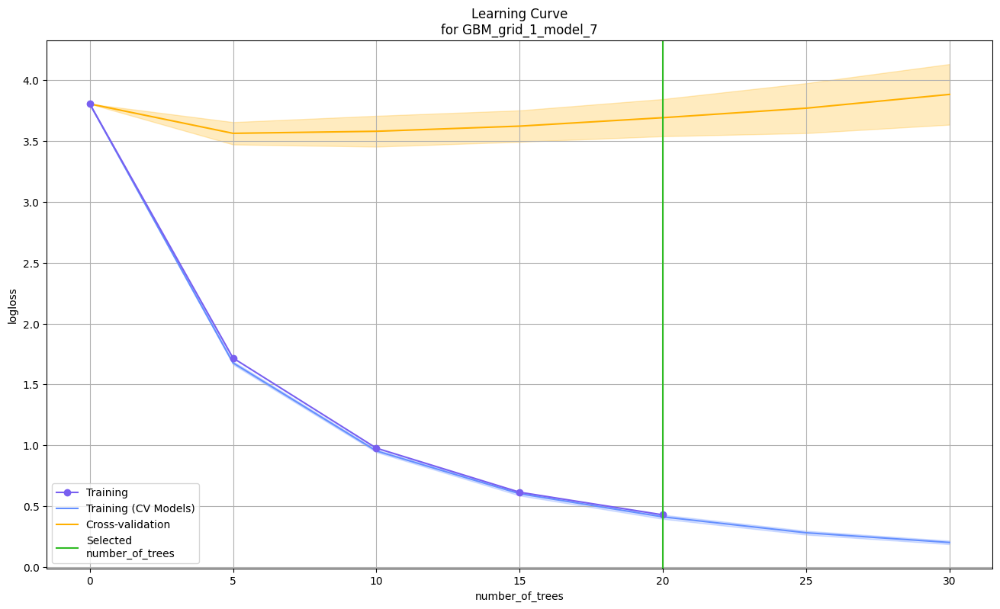

# Variable Importance

> The variable importance plot shows the relative importance of the most important variables in the model.

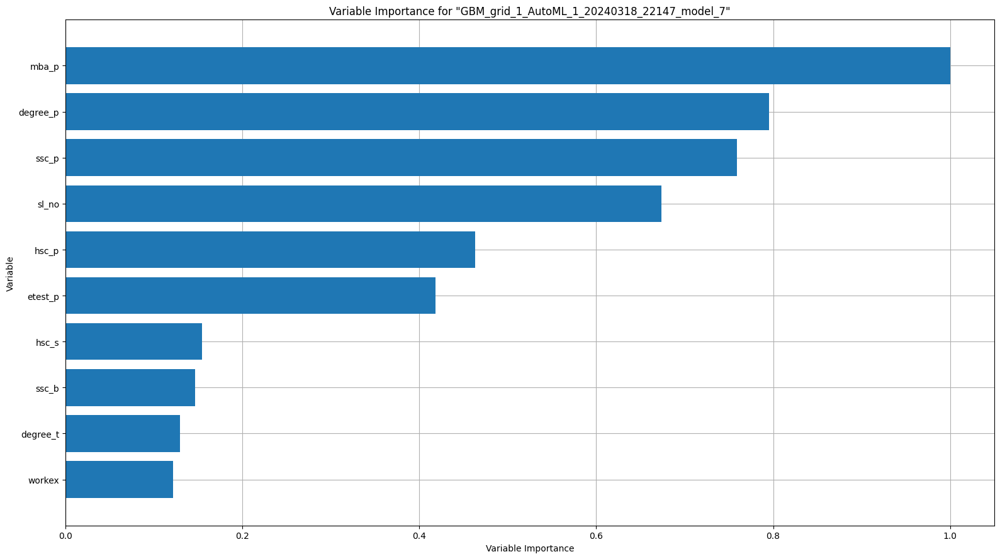

# Partial Dependence Plots

> Partial dependence plot (PDP) gives a graphical depiction of the marginal effect of a variable on the response. The effect of a variable is measured in change in the mean response. PDP assumes independence between the feature for which is the PDP computed and the rest.

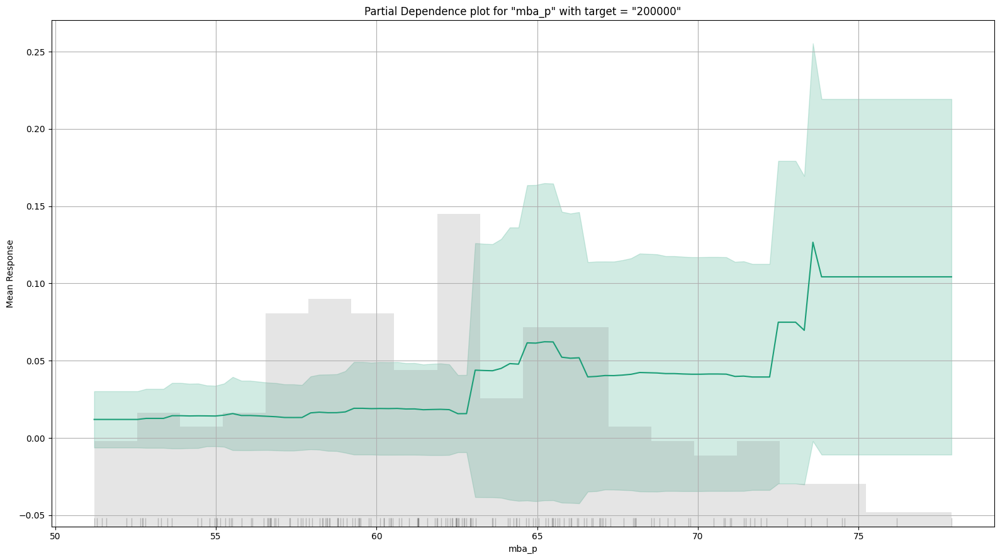

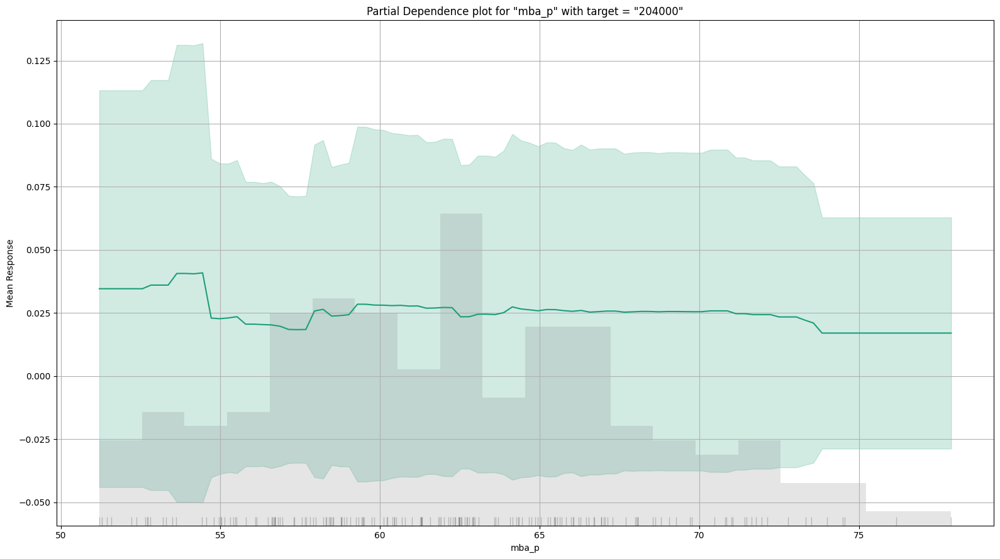

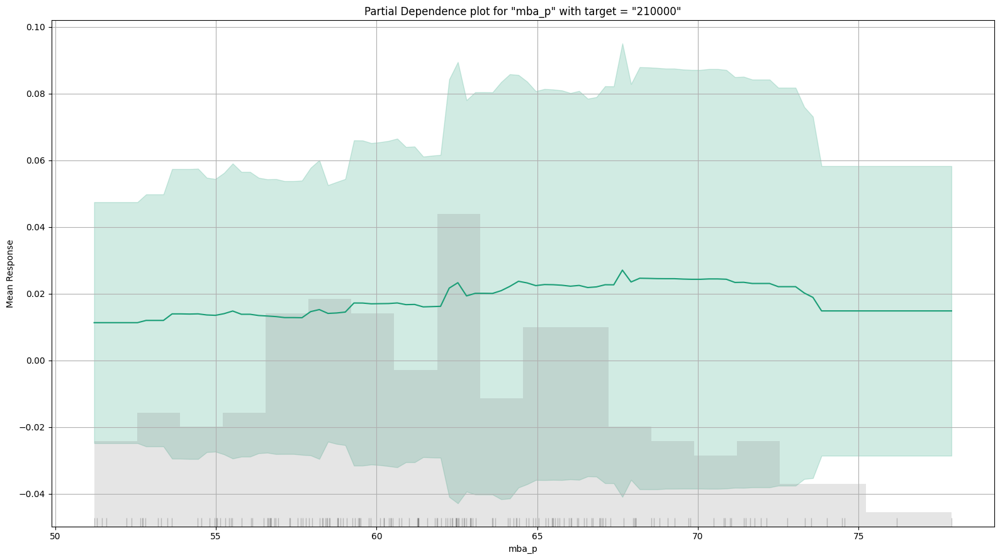

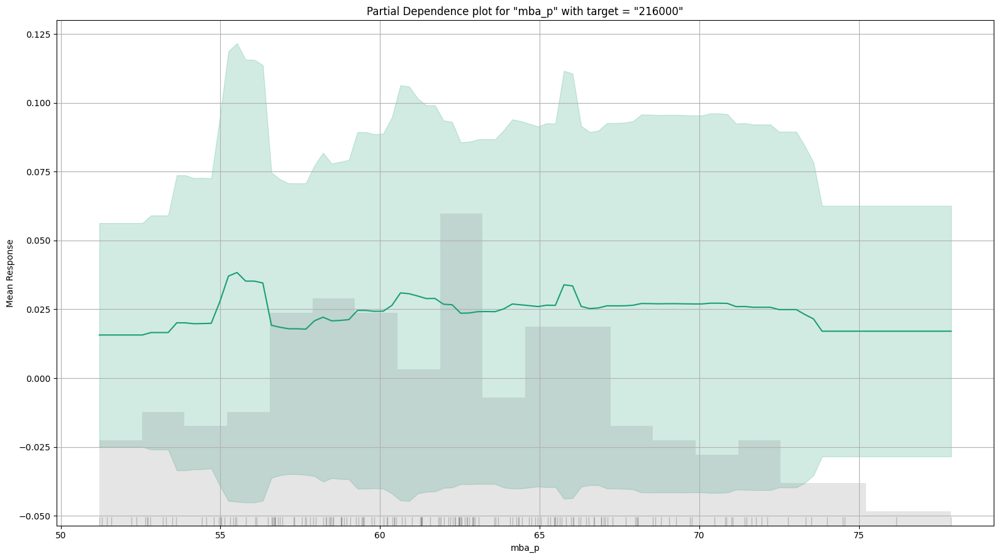

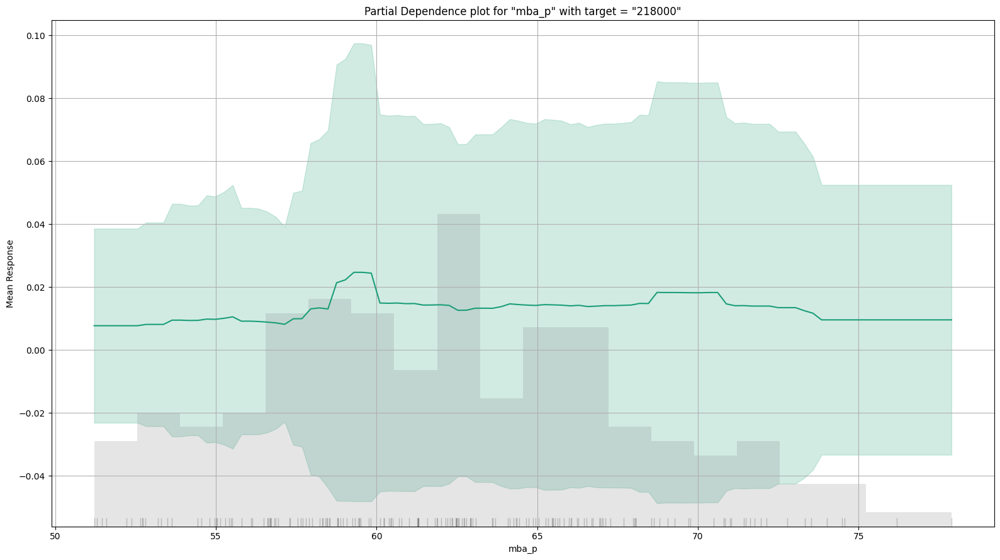

...

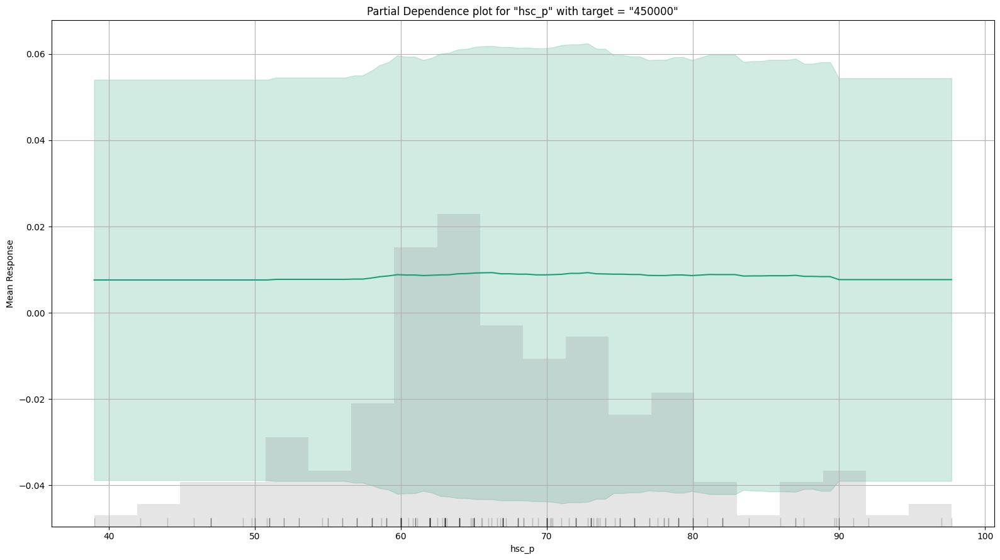

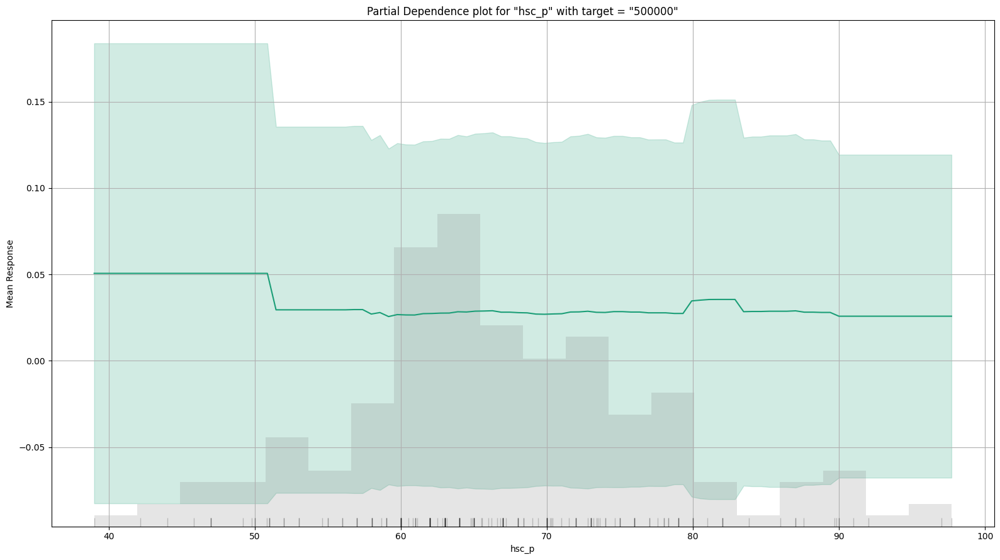

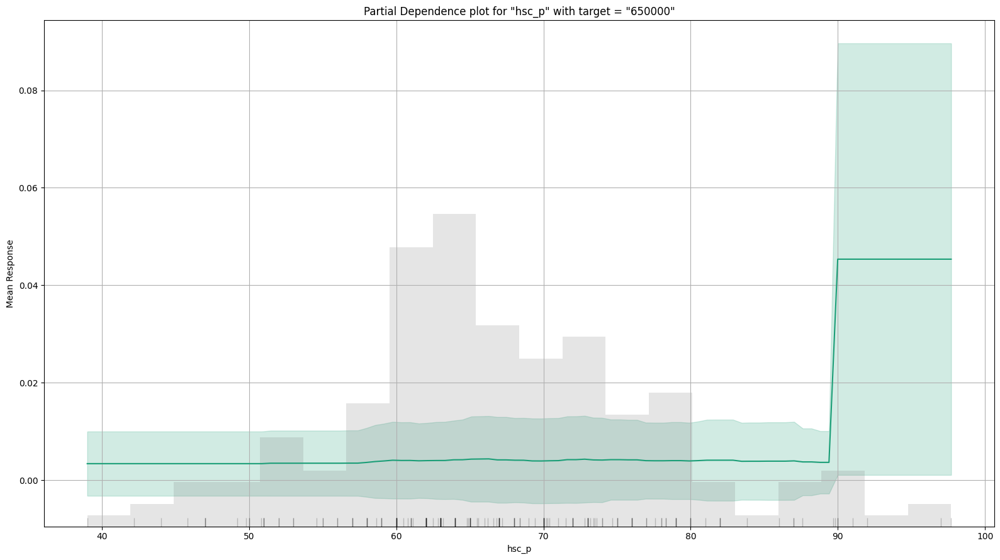

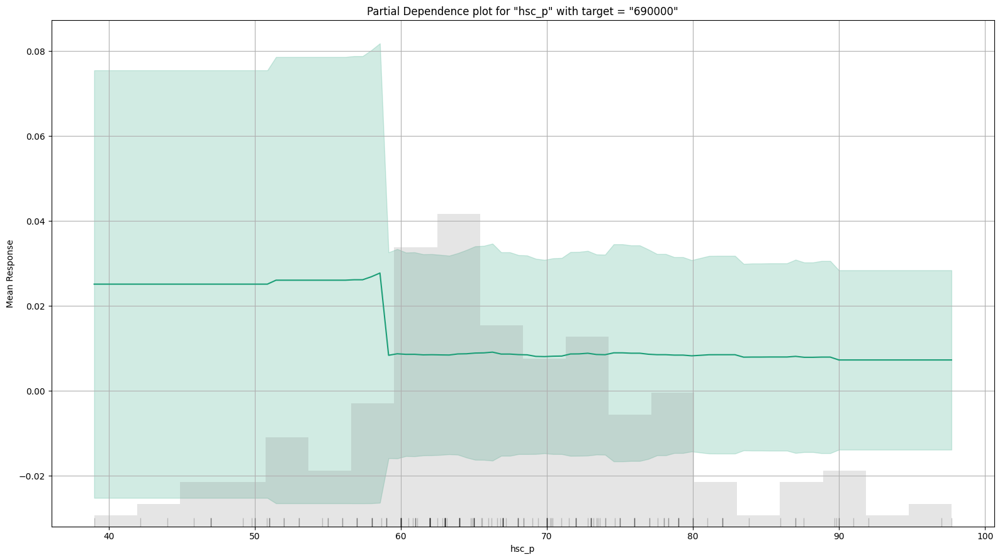

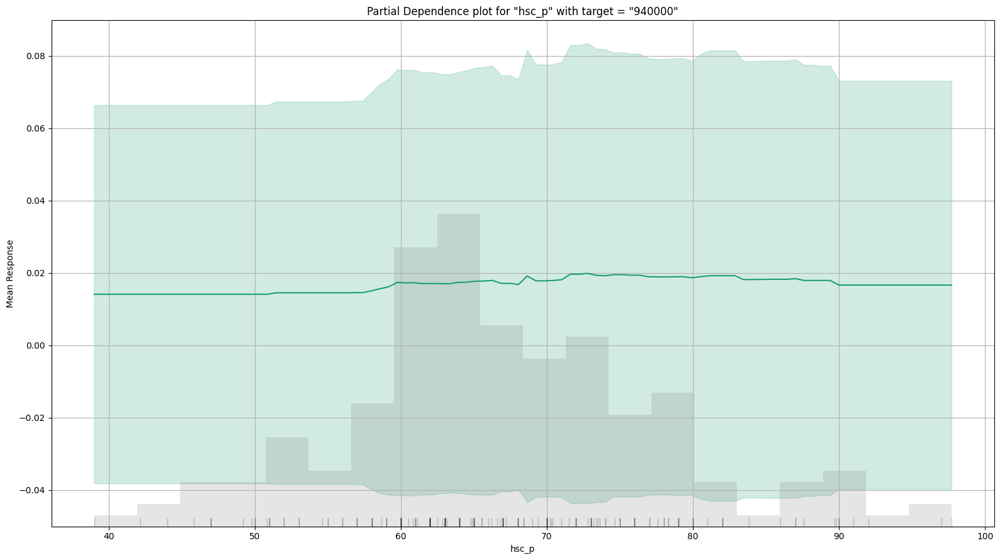

# Confusion Matrix

> Confusion matrix shows a predicted class vs an actual class.

## GBM_grid_1_AutoML_1_20240318_22147_model_7

200000,204000,210000,216000,218000,220000,225000,230000,231000,233000,236000,240000,250000,252000,255000,260000,264000,265000,268000,270000,275000,276000,278000,280000,285000,287000,290000,295000,300000,320000,336000,340000,350000,360000,380000,393000,400000,411000,420000,425000,450000,500000,650000,690000,940000,Error,Rate
5.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0 / 5
0.0,2.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0 / 2
0.0,0.0,3.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0 / 3
0.0,0.0,0.0,3.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0 / 3
0.0,0.0,0.0,0.0,2.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0 / 2
0.0,0.0,0.0,0.0,0.0,4.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0 / 4
0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,nan,0 / 0
0.0,0.0,0.0,0.0,0.0,0.0,0.0,2.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0 / 2
0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0 / 1
0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0 / 1


# Learning Curve Plot

> Learning curve plot shows the loss function/metric dependent on number of iterations or trees for tree-based algorithms. This plot can be useful for determining whether the model overfits.

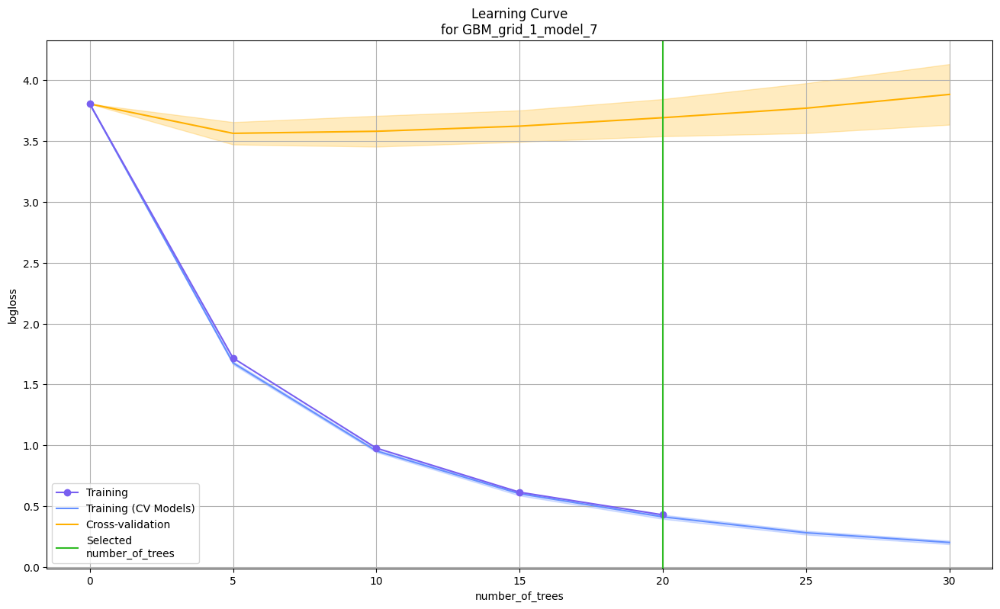

# Variable Importance

> The variable importance plot shows the relative importance of the most important variables in the model.

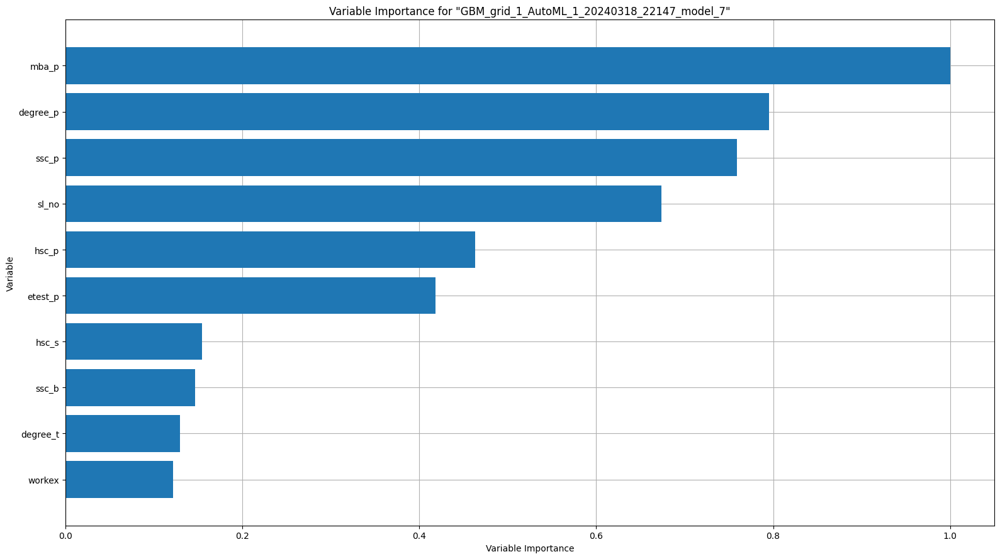

# Partial Dependence Plots

> Partial dependence plot (PDP) gives a graphical depiction of the marginal effect of a variable on the response. The effect of a variable is measured in change in the mean response. PDP assumes independence between the feature for which is the PDP computed and the rest.

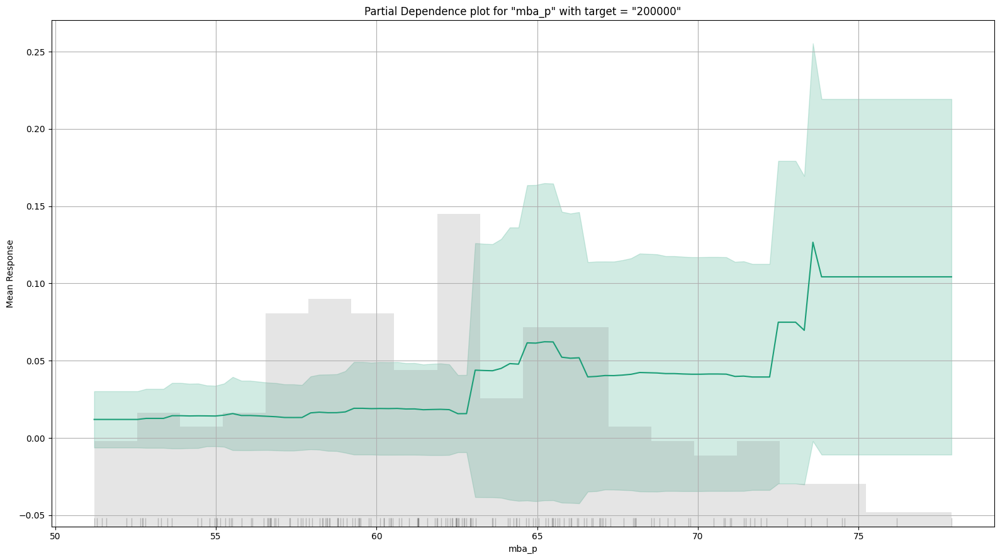

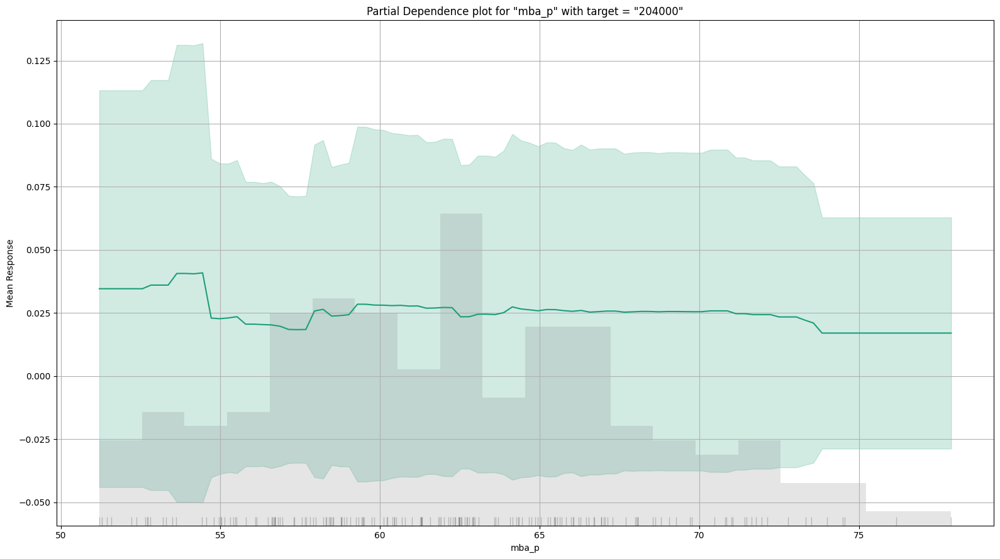

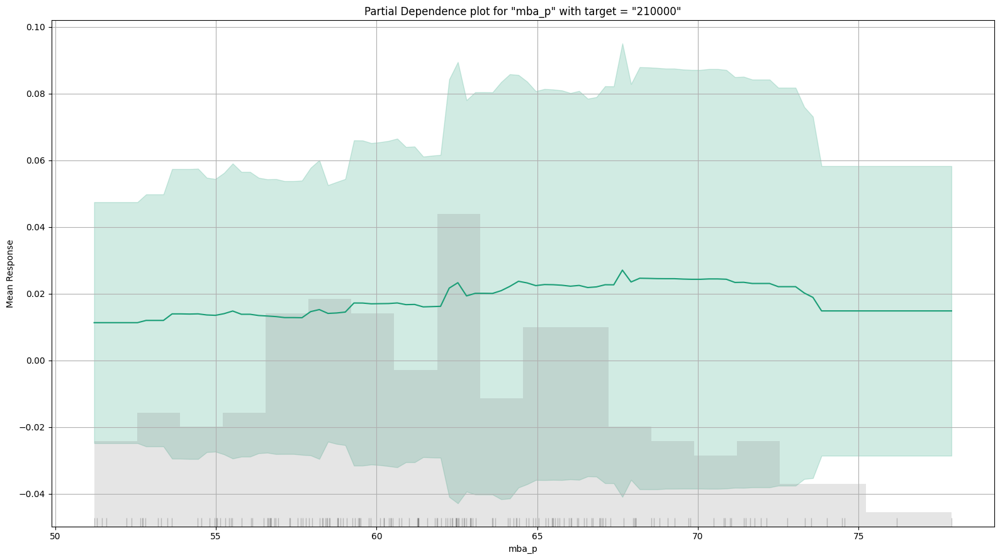

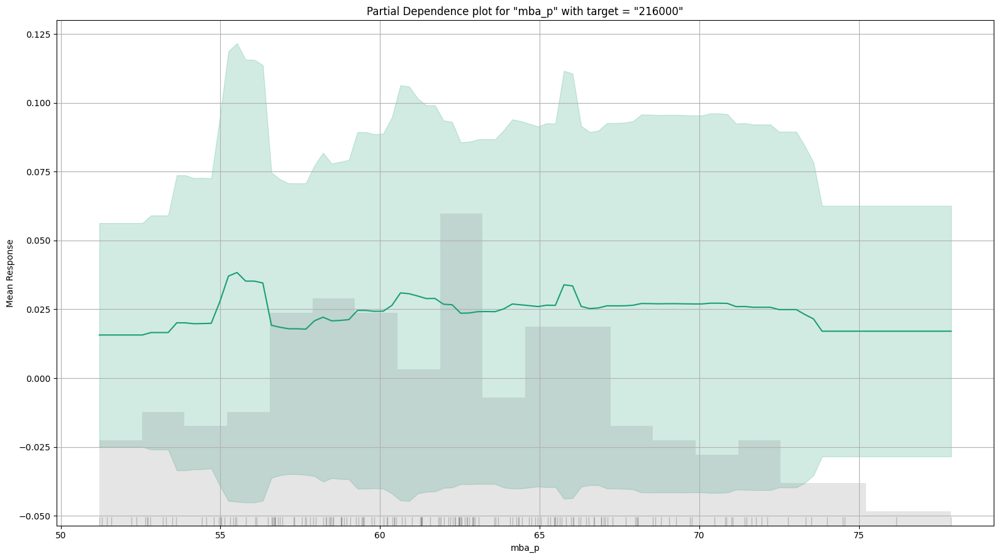

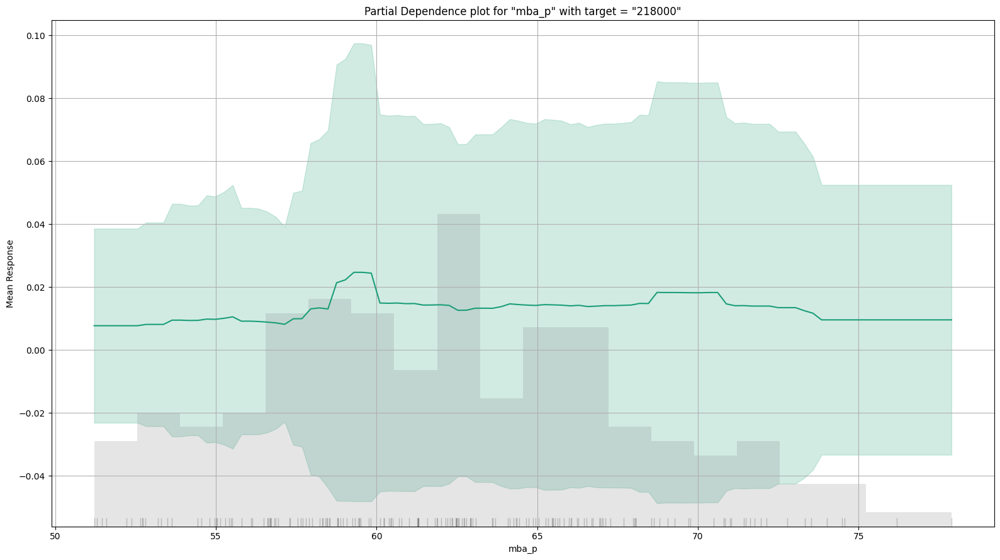

...

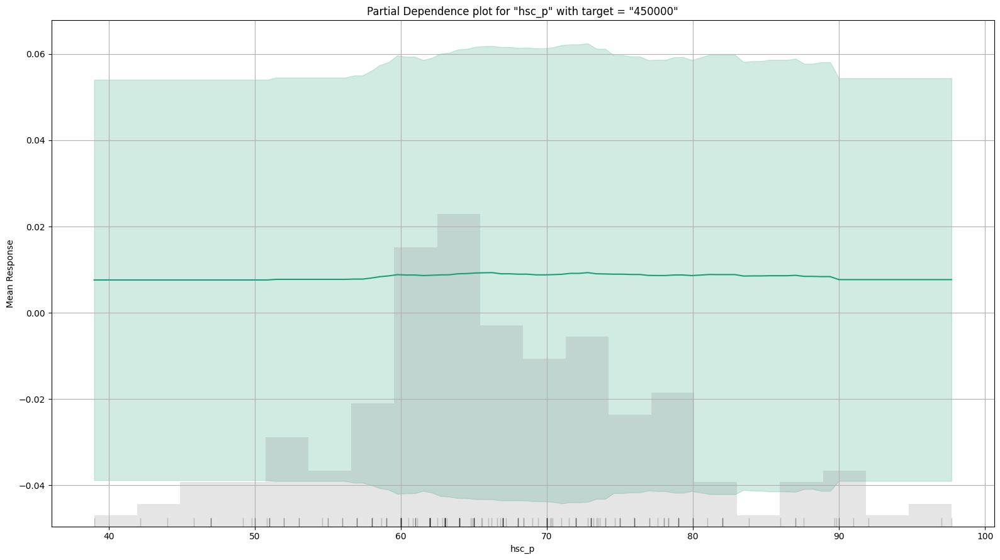

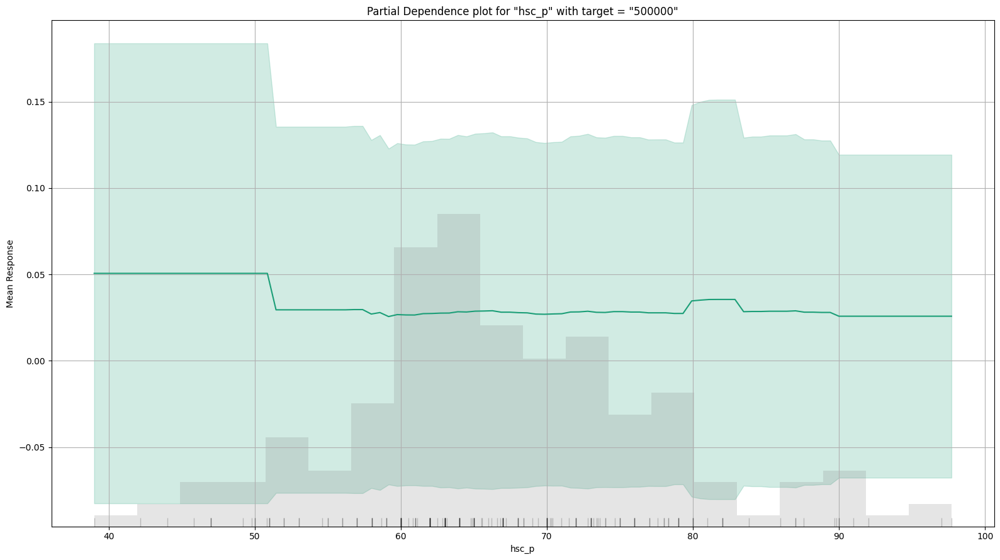

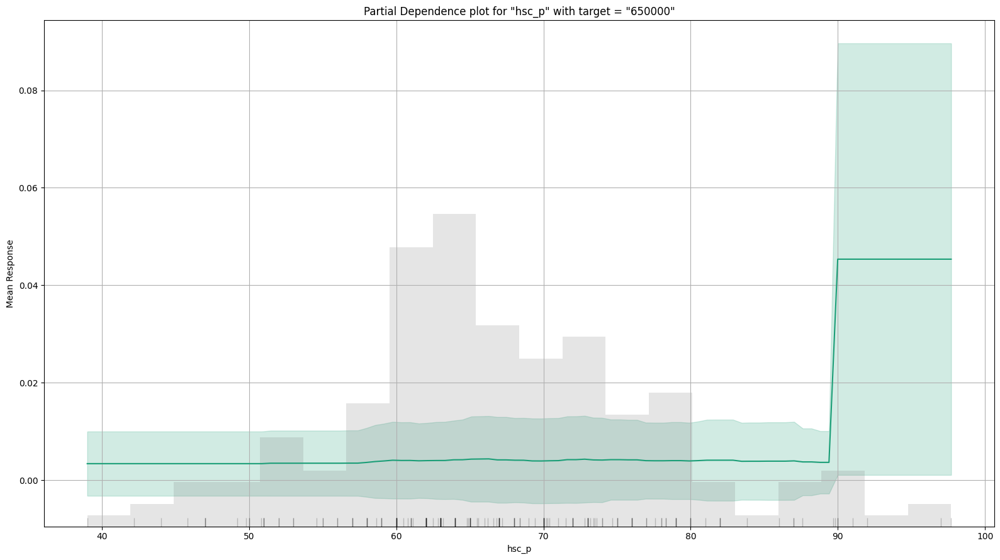

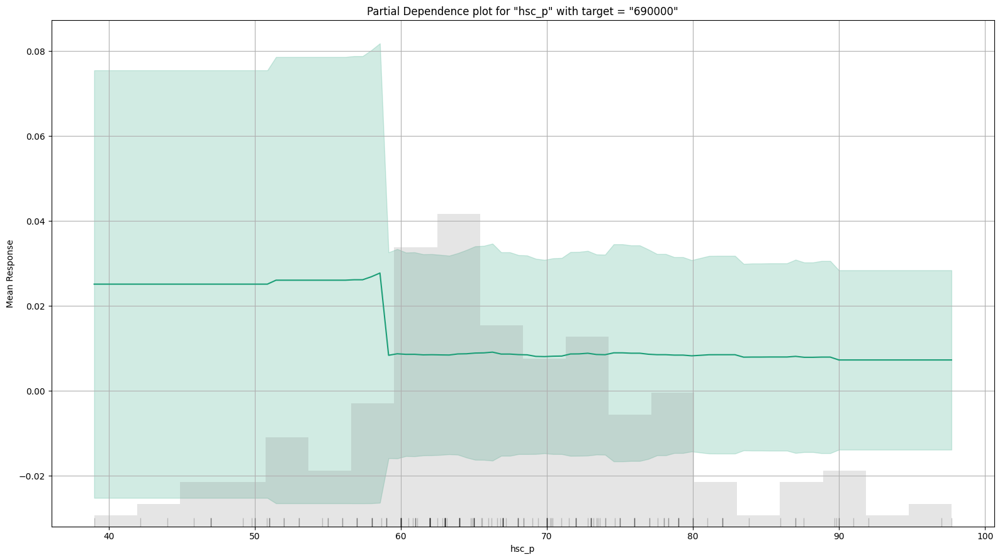

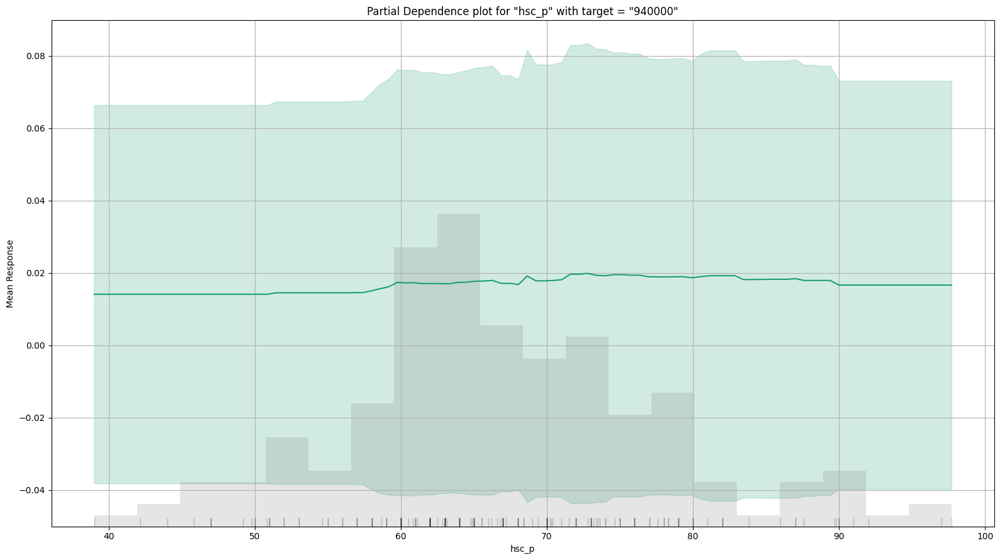

In [42]:
best_model.explain(data_train)

In [43]:
best_model.algo

'gbm'

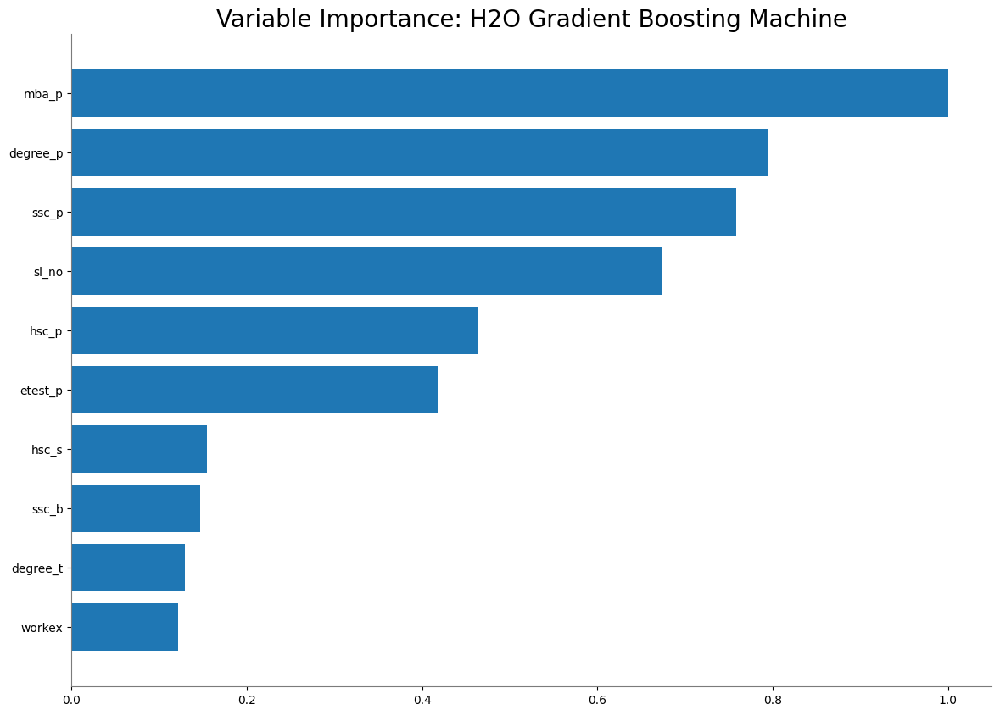

<Figure size 50000x10000 with 0 Axes>

In [44]:
if best_model.algo in ['gbm','drf','xrt','xgboost']:
  best_model.varimp_plot()

Above code checks if the algorithm of best_model is one of the specified algorithms. If it is, it calls the varimp_plot() method to generate the variable importance plot.

In [46]:
if glm_index is not 0:
  print(glm_index)
  glm_model=h2o.get_model(auml.leaderboard[glm_index,'model_id'])
  print(glm_model.algo)

# glm_model.std_coef_plot()

<>:1: SyntaxWarning: "is not" with a literal. Did you mean "!="?
<>:1: SyntaxWarning: "is not" with a literal. Did you mean "!="?
<ipython-input-46-b2df007da33a>:1: SyntaxWarning: "is not" with a literal. Did you mean "!="?
  if glm_index is not 0:


9
glm


In [47]:
print(best_model.auc(train = True))

NaN


The above print() command prints the area under curve for the best suitable algorithm ie GBM and area under curve is none.

In [48]:
def model_performance_stats(perf):
    d={}
    try:
      d['mse']=perf.mse()
    except:
      pass
    try:
      d['rmse']=perf.rmse()
    except:
      pass
    try:
      d['null_degrees_of_freedom']=perf.null_degrees_of_freedom()
    except:
      pass
    try:
      d['residual_degrees_of_freedom']=perf.residual_degrees_of_freedom()
    except:
      pass
    try:
      d['residual_deviance']=perf.residual_deviance()
    except:
      pass
    try:
      d['null_deviance']=perf.null_deviance()
    except:
      pass
    try:
      d['aic']=perf.aic()
    except:
      pass
    try:
      d['logloss']=perf.logloss()
    except:
      pass
    try:
      d['auc']=perf.auc()
    except:
      pass
    try:
      d['gini']=perf.gini()
    except:
      pass
    return d

The Python function `model_performance_stats` which takes a single argument `perf`, presumably a model performance object. The function initializes an empty dictionary `d` and attempts to retrieve various model performance metrics using methods such as `.mse()`, `.rmse()`, `.null_degrees_of_freedom()`, `.residual_degrees_of_freedom()`, `.residual_deviance()`, `.null_deviance()`, `.aic()`, `.logloss()`, `.auc()`, and `.gini()`. For each metric, the function tries to call the corresponding method on the `perf` object and store the result in the dictionary with the metric's name as the key.

If any of these methods raises an exception (presumably because the metric is not applicable or available for the particular model), the function silently passes over the error without interrupting the execution, due to the use of a bare `except: pass` structure. This design choice ensures that the function collects as many metrics as are available, ignoring those that aren't without failing. The final line `return d` returns the dictionary of collected performance statistics.

This function is versatile and robust against errors, making it suitable for use with different types of model performance objects that may not all support the same set of performance metrics. However, it does not log or handle exceptions beyond ignoring them, which means that it will not provide feedback if a metric is not available due to some issue other than the metric being inapplicable for the model type.

In [49]:
mod_perf=best_model.model_performance(data_test)
stats_test={}
stats_test=model_performance_stats(mod_perf)
stats_test

{'mse': 0.8651165550996041,
 'rmse': 0.9301164201859916,
 'null_degrees_of_freedom': None,
 'residual_degrees_of_freedom': None,
 'residual_deviance': None,
 'null_deviance': None,
 'aic': 'NaN',
 'logloss': 3.5130644330020866,
 'auc': 'NaN'}

The Python code block that uses the previously defined `model_performance_stats` function to extract performance metrics for the `best_model` on a test dataset (`data_test`). The resulting `stats_test` dictionary includes values for mean squared error (MSE) and root mean squared error (RMSE), indicating the model's average error magnitude. These values are non-null and numeric, suggesting that the model has made predictions with quantifiable errors.

However, several metrics, specifically `null_degrees_of_freedom`, `residual_degrees_of_freedom`, and `residual_deviance`, are `None`, while `aic` (Akaike Information Criterion), and `auc` (Area Under the ROC Curve) are 'NaN' (Not a Number). This could indicate that these particular statistics are not applicable or cannot be computed for the given model or test data set. The non-null log loss value suggests that the model's predicted probabilities are being evaluated against the actual outcomes, providing insight into the model's calibration.

#Initialising the shap analysis on the model from step 1,2,3

In [50]:
!pip install shap

The terminal output from the execution of the command `!pip install shap`, which is used to install the SHAP (SHapley Additive exPlanations) library in Python, a tool used for explaining the output of machine learning models. The output indicates that SHAP version 0.45.0 was successfully installed. During the installation, several requirements were already satisfied, indicating that the necessary dependencies for SHAP were previously installed in the environment. Additionally, the library `slicer` version 0.0.7, a dependency of SHAP, was collected and installed during the process. The terminal output does not show any errors, suggesting the installation went smoothly.

In [51]:
import shap

In [52]:
lg_explainer = shap.Explainer(logreg, X_train)
shap_values_lg = lg_explainer(X_test)

The code snippet initializes a SHAP `Explainer` for a logistic regression model (`logreg`) using the training data `X_train` to understand the model's feature importances and how different features impact the model's predictions. Once the explainer is initialized, it is then applied to the test data `X_test` to compute SHAP values.

These SHAP values quantify the impact of each feature on the model's output for each instance in the `X_test` dataset. Higher SHAP values indicate a greater impact on the model's prediction, which can either increase or decrease the predicted probability, depending on the sign of the SHAP value and the feature's value. However, the actual output from running this code isn't provided; typically, one would expect an array or a matrix of SHAP values where rows correspond to instances in `X_test` and columns correspond to features. This output can then be used for detailed analysis and visualization of the feature contributions to model predictions.

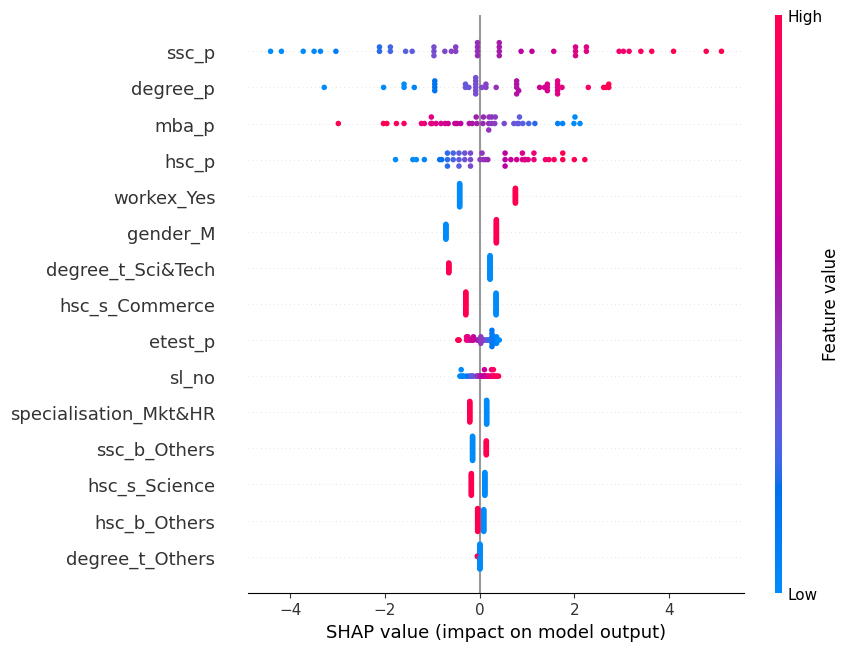

In [53]:
shap.plots.beeswarm(shap_values_lg, max_display=15)

The image shows a SHAP beeswarm plot, which is a compact visualization of feature importance and effects on a model's predictions. Each point represents a SHAP value for a feature and an instance. Features are ordered by the sum of SHAP value magnitudes over all samples, and color represents the feature value (red high, blue low).

The plot indicates that `ssc_p`, `degree_p`, and `mba_p` are likely the top three features impacting the model output positively, as they have a concentration of points to the right, showing positive SHAP values. In contrast, `hsc_b_Others` and `degree_t_Others` tend to have negative impacts on the model output, given their points are skewed to the left, indicating negative SHAP values. The color spread suggests that for some features, like `gender_M` and `workex_Yes`, both high and low values can have a significant impact on the model's output.

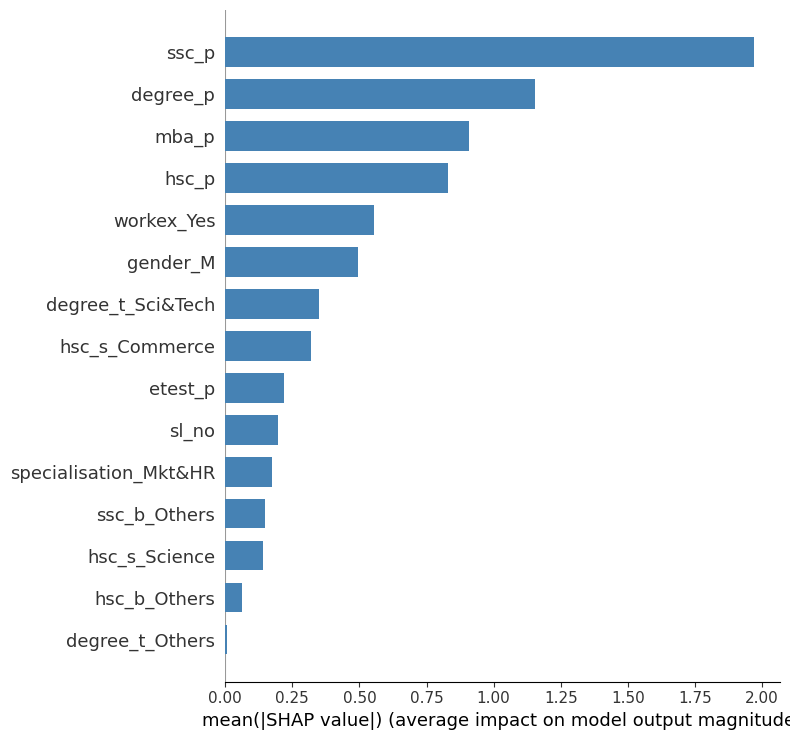

In [54]:
shap.summary_plot(shap_values_lg, X_train, plot_type="bar", color='steelblue')

A bar plot from the SHAP library summarizing the average impact of each feature on the model output magnitude. The length of the bar represents the mean absolute SHAP value for each feature, which is a measure of feature importance. Features like `ssc_p`, `degree_p`, and `mba_p` have the longest bars, indicating they have the greatest average impact on the model's predictions. On the other hand, features such as `degree_t_Others`, `hsc_b_Others`, and `hsc_s_Science` have shorter bars, suggesting they have a lesser average impact on the model output. The color 'steelblue' does not signify anything other than a stylistic choice for the bars. The plot is useful for quickly identifying which features are most influential in the model's decision-making process.

In [55]:
explainer = shap.TreeExplainer(xgb_cl)
shap_values = explainer.shap_values(X_train,approximate=False, check_additivity=False)

The code creates a SHAP `TreeExplainer` for an XGBoost classifier (`xgb_cl`) and then computes SHAP values for the training data (`X_train`). The SHAP values are calculated without approximation (`approximate=False`) and without checking for additivity (`check_additivity=False`).
The output of `shap_values` would be an array of SHAP values that quantify the contribution of each feature to the prediction of each instance in `X_train`. The computed SHAP values provide insights into the model's decision process, indicating how each feature pushes the model output from the base value (the output that would be predicted if we did not know any features for the current output) towards the actual prediction. The lack of approximation suggests that the SHAP values are calculated exactly, which could be computationally intensive for large datasets. Disabling additivity check can save computation time but should be used with caution, as it assumes the model predictions are fully captured by the SHAP values even when additivity does not hold.

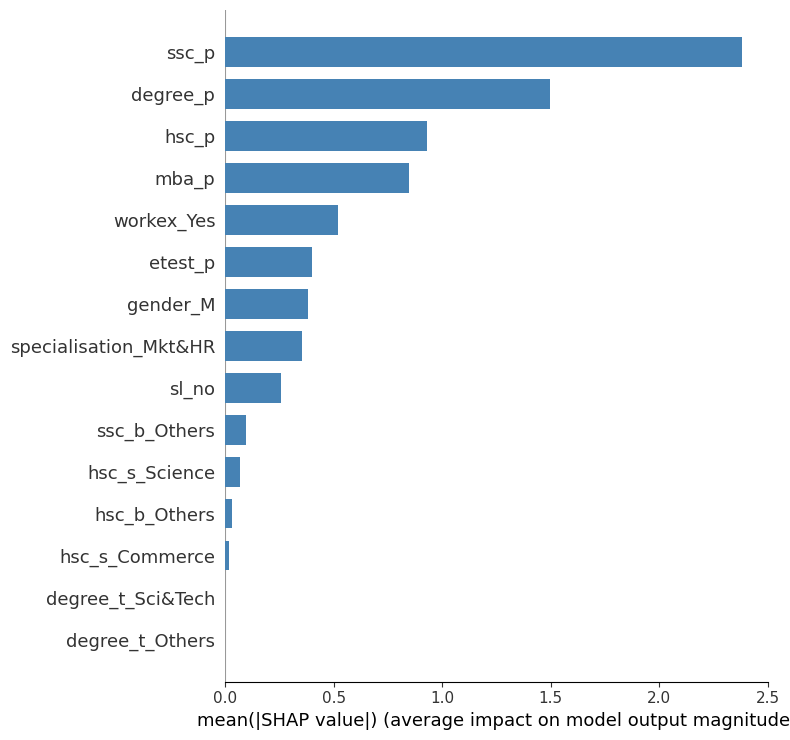

In [56]:
shap.summary_plot(shap_values, X_train, plot_type="bar", color='steelblue')

The SHAP summary bar plot, which illustrates the average impact of various features on the XGBoost model's output. Features are ranked in descending order of importance based on the mean absolute SHAP value. The feature `ssc_p` appears to have the highest average impact on the model's predictions, followed by `degree_p` and `hsc_p`. Features like `degree_t_Others` and `degree_t_Sci&Tech` are at the bottom of the plot, indicating a lower average impact on the model's output. The bars extend to the right, showing a positive impact on the model output magnitude. The plot offers a clear visualization of feature importance, revealing which features are most influential in driving the model's decisions. The color 'steelblue' is used consistently across all features for visual simplicity.

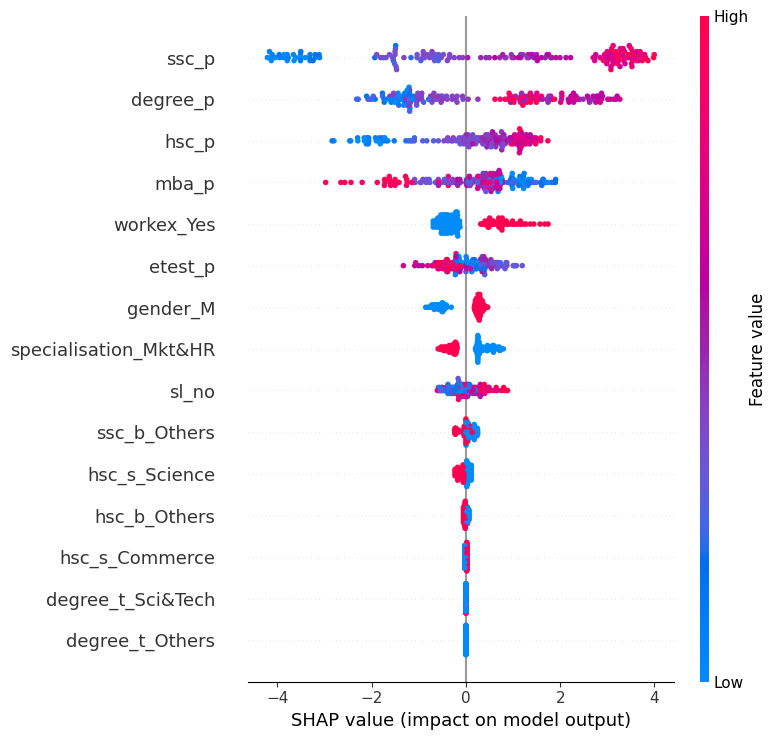

In [57]:
shap.summary_plot(shap_values, X_train)

The SHAP summary plot showing the distribution of SHAP values for each feature in a dataset. The x-axis represents the SHAP value, or the impact on the model output, while the y-axis lists the features. The color of the dots indicates the value of the feature: high values in pink/red and low values in blue. Features at the top of the plot, such as `ssc_p`, `degree_p`, and `hsc_p`, have a more significant impact on the model's predictions. The spread of dots across the zero line indicates variation in the impact of individual feature values on the model's predictions. For instance, `gender_M` and `specialisation_Mkt&HR` show a mixture of positive and negative effects on the model's output, indicated by the spread of dots on both sides of the zero line.



## Questions and their answers-

1)Fit a linear model and interpret the regression coefficients-

The odds ratios are sorted in descending order, which means the features at the top have the most substantial positive impact on the predicted probability of the outcome occurring (assuming a positive outcome is coded as 1).

**workex_Yes (3.249125):** Having work experience (workex_Yes = 1) is associated with approximately 3.25 times the odds of the positive outcome compared to not having work experience (workex_Yes = 0), holding other variables constant.

**gender_M (2.904948):** Being male (gender_M = 1) is associated with almost 2.91 times the odds of the positive outcome compared to not being male (gender_M = 0), holding other variables constant.

**ssc_b_Others (1.337639):** Being from an "others" school board (ssc_b_Others = 1) is associated with 1.34 times the odds of the positive outcome compared to not being from an "others" school board (ssc_b_Others = 0), holding other variables constant.

The odds ratios for other variables like `ssc_b_Others`, `ssc_p`, `degree_p`, and `hsc_p` are greater than 1, which means they are positively associated with the outcome, although their influence is less pronounced than work experience and gender.

Variables close to an odds ratio of 1, such as `sl_no` (approximately 1.004), have a very minimal impact on the likelihood of the outcome.

The positive values indicate an increased likelihood of the positive outcome, while values below 1 would indicate a decreased likelihood of the positive outcome.

2) Fit a tree-based model and interpret the nodes-
Fit a tree-based model and interpret the nodes Ans: The plot below interprets all nodes (root, leaf, and intermediate) and displays the first tree plotted with the XGBoost algorithm. This figure shows how the model arrived at its final decisions and what splits it took to reach those results. As per the below plot, the root node is 'ssc_p'.

3) Use auto ml to find the best model-
The best model from an H2O AutoML leaderboard. It prints the value of `model_index`, which is 0, indicating that the best model according to the AutoML leaderboard is at the first index of the leaderboard DataFrame. Following that, it uses the `h2o.get_model` function to retrieve the model with the ID at the `model_index` position in the leaderboard. The output `0` suggests that the `model_index` corresponds to the very first model in the AutoML leaderboard.

'mba_p' is the most important feature, with the highest relative importance and a scaled importance of 1.0, meaning it has the most significant impact on the model's predictions. 'etest_p' and 'hsc_p' follow in importance, with relative importances of 28.52 and 25.76 respectively, and scaled importances that are both above 0.8.

4) Run SHAP analysis on the models from steps 1, 2, and 3, interpret the SHAP values and compare them with the other model interpretability methods. Ans:After running SHAP analysis on model 1 (i.e. Logistic Regression), we have found that 'ssc_p' is the top feature in the dataset impacting the model’s output as represented in the beeswarm and summary plots whereas 'degree_t_other' is the least important feature.

##Conclusion

Build a predictive model using Logistic regression, XGBoost, AutoML to predict whether a student is placed or not placed during campus Recruitment. Model interpretability was tested using shap analysis by plotting beeswarm and shap summary plots to compare all three models. We discovered that all three algorithms produce distinct outcomes, and that regularization can be used to improve the models.

##LICENSE

MIT License
Copyright (c) 2024 Sohni Rais
Permission is hereby granted, free of charge, to any person obtaining a copy of this software and associated documentation files (the "Software"), to deal in the Software without restriction, including without limitation the rights to use, copy, modify, merge, publish, distribute, sublicense, and/or sell copies of the Software, and to permit persons to whom the Software is furnished to do so, subject to the following conditions: The above copyright notice and this permission notice shall be included in all copies or substantial portions of the Software.
THE SOFTWARE IS PROVIDED "AS IS", WITHOUT WARRANTY OF ANY KIND, EXPRESS OR IMPLIED, INCLUDING BUT NOT LIMITED TO THE WARRANTIES OF MERCHANTABILITY, FITNESS FOR A PARTICULAR PURPOSE AND NONINFRINGEMENT. IN NO EVENT SHALL THE AUTHORS OR COPYRIGHT HOLDERS BE LIABLE FOR ANY CLAIM, DAMAGES OR OTHER LIABILITY, WHETHER IN AN ACTION OF CONTRACT, TORT OR OTHERWISE, ARISING FROM, OUT OF OR IN CONNECTION WITH THE SOFTWARE OR THE USE OR OTHER DEALINGS IN THE SOFTWARE.

References:-

1) https://towardsdatascience.com/interpreting-coefficients-in-linear-and-logistic-regression-6ddf1295f6f1

2) https://towardsdatascience.com/decision-trees-explained-3ec41632ceb6

3) https://www.datacamp.com/community/tutorials/xgboost-in-python

4) https://www.analyticsvidhya.com/blog/2020/10/all-about-decision-tree-from-scratch-with-python-implementation/

5) https://github.com/SanatPopliNEU/Data-engineering-and-tools-by-Nick-Bear-Browns_asssignments/blob/main/datsciencelearn/Model%20Interpret_SanatPopli_002201005-4.ipynb